In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
#pip install pandas_ta

In [3]:
import pandas_ta as ta

In [4]:
import random
import math
import os
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

In [5]:
# Everything concerning USDTRY pair is done here, after testing the models CHECK THIS PART!
bist_daily = pd.read_csv("datasets/bist_100_daily.csv")
usdtry_daily = pd.read_csv('datasets/USDTRY_daily.csv')
usdtry_daily = usdtry_daily[["Date","USDTRY_Close"]]
usdtry_daily["Date"]=pd.to_datetime(usdtry_daily["Date"])
bist_daily["Date"] = pd.to_datetime(bist_daily["Date"])
bist_daily = bist_daily.merge(usdtry_daily, how='inner',on="Date")


# Extract the number of rows and columns by using the shape of the data.
numRows,numColumns = bist_daily.shape
# Extract the time interval.
last_date, first_date = bist_daily.iloc[0].Date, bist_daily.iloc[-1].Date
# Check the availability of the data.
na_cols = bist_daily.columns[bist_daily.isna().any()].tolist()

# Print the information.
print(f"There are {numRows} rows and {numColumns} columns in the initial dataset.")
print(f"The data represents the time frame between the dates '{last_date}' and '{first_date}'.")
if not na_cols:
    print("There are no NA rows.")
else:
    print(f"Columns in the dataset which include NA rows: {na_cols}.")
# Convert columns to numeric values
column_names = ["Price", "Open", "High", "Low"]
for column in column_names:
    bist_daily[column] = bist_daily[column].str.replace(',', '')
    bist_daily[column] = pd.to_numeric(bist_daily[column])
# CONVERT TO DATETIME FORMAT AND SORT DATA BY DATE
bist_daily.Date = pd.to_datetime(bist_daily.Date)
bist_daily.sort_values(by="Date", ignore_index=True,inplace=True)
bist_daily.set_index(pd.DatetimeIndex(bist_daily["Date"]), inplace=True)
bist_daily.rename(columns={"Price": "close"},inplace=True)
# Calculate Returns and append to the df DataFrame
# CUMLOGRET_1 and CUMPCTRET_1 are added (NaN values exists)
bist_daily.ta.log_return(cumulative=True, append=True)
bist_daily.ta.percent_return(cumulative=True, append=True)
# Returns a list of indicators and utility functions (to check in future)
ind_list = bist_daily.ta.indicators(as_list=True)
# RSI_14, MACD_12_26_9, MACDh_12_26_9 and MACDs_12_26_9 are added (NaN values exists)
bist_daily.ta.rsi(append=True)
bist_daily.ta.macd(append=True)
# SMA values are added (use ta in the future)
sma_values = [5, 10, 15] 
for i in sma_values:
    bist_daily['SMA'+str(i)] = bist_daily['close'].rolling(window=i).mean()
# Remove all NaN value rows
bist_daily.dropna(inplace=True)
bist_daily

There are 4285 rows and 8 columns in the initial dataset.
The data represents the time frame between the dates '2019-12-02 00:00:00' and '2000-01-05 00:00:00'.
There are no NA rows.


,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38.20M,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60.08M,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53.29M,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33.31M,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44.39M,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1.04B,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970.54M,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1.81B,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


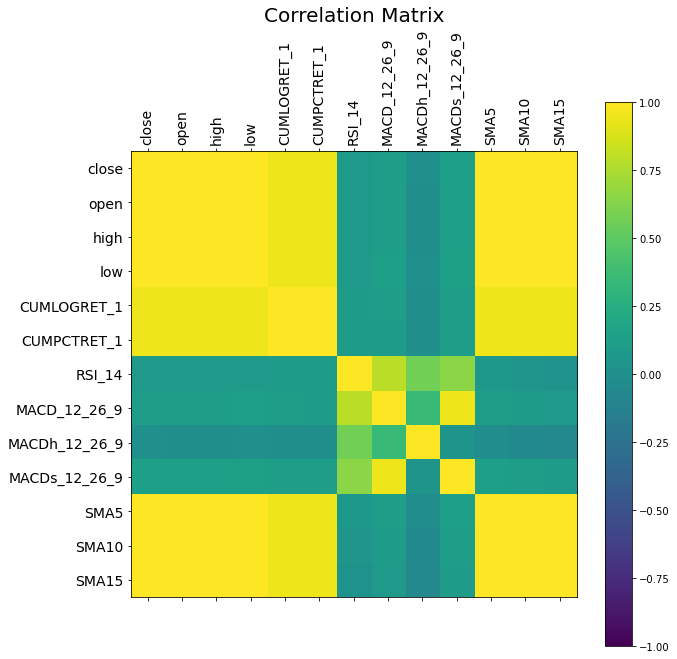

In [6]:
# Visualize the correlation matrix.
fig = plt.figure(figsize=(10,10)) 
ax = fig.add_subplot(111) # 1x1 grid, first subplot.
fig.colorbar(ax.matshow(bist_daily.corr(), vmin=-1, vmax=1)) 
ticks = np.arange(len(bist_daily.corr().columns))
ax.tick_params(axis='x', which='major', labelsize=14, rotation=90)
ax.tick_params(axis='y', which='major', labelsize=14, rotation=0)
ax.set_xticks(ticks)
ax.set_yticks(ticks)
ax.set_xticklabels(bist_daily.corr().columns)
ax.set_yticklabels(bist_daily.corr().columns)
plt.title("Correlation Matrix", fontsize=20)
plt.show()

{1: 2938, 2: 308, 3: 775, 4: 125, 5: 64, 6: 15, 7: 10, 10: 3, 11: 3, 12: 2, 28: 1, 29: 2, 31: 4, 60: 1}


<BarContainer object of 14 artists>

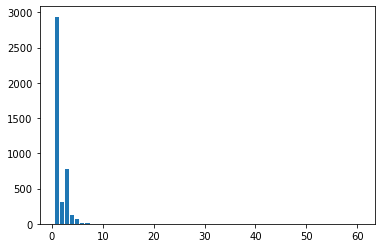

In [7]:
diff = [] 
for date1, date2 in zip(bist_daily["date"][:-1], bist_daily["date"][1:]): 
    diff.append((date2-date1).days) 
unique, counts = np.unique(np.asarray(diff), return_counts=True) 
count_dict = dict(zip(unique, counts)) 
print(count_dict) 
plt.bar(unique,counts)

In [8]:
# edit Vol. column

from operator import itemgetter

vols = bist_daily['Vol.'].to_list()
#[vol[-1] for vol in vols]
#list(filter(lambda vol: "-" in vol,enumerate(vols)))

indexToRemove = bist_daily.iloc[list(map(itemgetter(0),filter(lambda vol: "-" in vol,enumerate(vols))))].index
bist_daily.drop(indexToRemove,inplace=True)
bist_daily['Vol.'] = bist_daily['Vol.'].apply(
    lambda x: float(x[:-1])*(10**6) if x[-1]=="M" else (float(x[:-1])*(10**9) if x[-1]=="B" else "ERROR")).astype("int")
bist_daily

,date,close,open,high,low,Vol.,Change %,USDTRY_Close,CUMLOGRET_1,CUMPCTRET_1,RSI_14,MACD_12_26_9,MACDh_12_26_9,MACDs_12_26_9,SMA5,SMA10,SMA15
date,,,,,,,,,,,,,,,,,
2000-02-29,2000-02-29,159.46,153.15,159.46,151.12,38200000,4.12%,"0,5743",-0.059997,-0.031662,50.482972,-7.536726,2.021502,-9.558229,149.956,150.081,152.436667
2000-03-02,2000-03-02,169.40,171.99,174.08,166.83,60080000,-1.51%,"0,5592",0.000472,0.030673,57.007643,-5.687707,3.096417,-8.784124,156.942,151.187,153.030000
2000-03-03,2000-03-03,167.84,169.40,170.67,163.96,53290000,-0.92%,"0,5771",-0.008779,0.021464,55.765721,-4.298673,3.588361,-7.887034,161.206,152.629,153.666000
2000-03-07,2000-03-07,172.23,165.63,172.23,163.13,33310000,3.98%,"0,6214",0.017040,0.047620,58.505269,-2.811211,4.060658,-6.871869,164.416,154.488,154.749333
2000-03-08,2000-03-08,173.44,172.23,175.01,169.28,44390000,0.70%,"0,6420",0.024041,0.054646,59.254312,-1.517260,4.283688,-5.800948,168.474,157.263,156.154000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-08-01,2019-08-01,1019.00,1013.42,1021.83,1010.93,1040000000,-0.18%,"5,4811",1.794787,2.848509,56.453510,-2.625148,0.532934,-3.158082,983.092,961.746,988.730667
2019-08-02,2019-08-02,996.79,1015.08,1017.07,996.30,970540000,-2.18%,"5,2474",1.772750,2.826713,51.628336,-1.558935,1.279317,-2.838253,1001.758,967.324,985.630000
2019-10-01,2019-10-01,1038.77,1052.75,1052.97,1031.89,1810000000,-1.10%,"5,4168",1.814002,2.868828,58.796876,2.643014,4.385014,-1.741999,1010.040,977.668,984.826667


In [5]:
# seeding an arbitrary number to get same results in multiple runs
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
print("Seed:", manualSeed)

Seed: 999


In [6]:
# getting number of GPUs from cuda
ngpu = torch.cuda.device_count()
print("Count of available GPUs:", ngpu)

Count of available GPUs: 1


In [7]:
# printing the name of available GPUs
for i in range(ngpu):
    print("GPU {}: {}".format(i+1, torch.cuda.get_device_name(i)))

GPU 1: GeForce RTX 2060


In [8]:
# batch size for the training
batch_size = 64

# optimizer rates
optimizer_betas = (0.9, 0.999)
learning_rate = 5e-4

# number of epochs
num_epochs = 100000

# evaluate after evaluation_epoch_num epochs
evaluation_epoch_num = 500

# decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

In [13]:
class TimeseriesDataset(Dataset):
    def __init__(self, data_frame, sequence_length=2):
        self.data = torch.tensor(data_frame.values)
        self.sequence_length = sequence_length

    def __len__(self):
        return self.data.shape[0] - self.sequence_length + 1

    def __getitem__(self, index):
        return self.data[index: index + self.sequence_length].float()
    
    # Non-overlapping series
    # def __getitem__(self, index):
    #     return self.data[index * self.sequence_length: (index+1) * self.sequence_length]

In [14]:
# create pytorch dataset from the pandas DataFrame

# TODO: Convert change(%) and Volume columns to numeric values
columns_used_in_training = ["close", "open", "high", "low", "CUMLOGRET_1", "RSI_14", "MACD_12_26_9", "SMA5"]
# input dimension of the generator
data_dimension = len(columns_used_in_training)
# sequence length of input data
sequence_length = 7

train_data, rest_data = train_test_split(bist_daily[columns_used_in_training], test_size=0.2, shuffle=False)

scaler = MinMaxScaler()
scaler.fit(train_data)
train_data[train_data.columns] = scaler.transform(train_data)
rest_data[rest_data.columns] = scaler.transform(rest_data)

validation_data, test_data = train_test_split(rest_data, test_size=0.5, shuffle=False)

train_dataset = TimeseriesDataset(train_data, sequence_length)
test_dataset = TimeseriesDataset(test_data, sequence_length)
validation_dataset = TimeseriesDataset(validation_data, sequence_length)

# create the dataloader
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size)
validation_dataloader = torch.utils.data.DataLoader(validation_dataset, batch_size=batch_size)
real_data_sample = next(iter(train_dataloader))
print("Real data sample shape:", real_data_sample.shape)

Real data sample shape: torch.Size([64, 7, 8])


In [15]:
class Regressor(nn.Module):
    def __init__(self, hidden_size):
        super(Regressor, self).__init__()
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size=data_dimension, hidden_size=hidden_size, num_layers=1, batch_first=True)
        self.linear = nn.Linear(hidden_size, data_dimension)
        self.drop = nn.Dropout(0.2)

    def forward(self, input_sequences):
        input_sequences = self.drop(input_sequences)
        lstm_output, hidden_cell = self.lstm(input_sequences)
        res = self.linear(hidden_cell[0][-1])
        return res

In [16]:
def model_rmse(model, dataloader, epoch, plot_graph=False, plot_title="Validation Predictions", show_preds=False):
    rmse = 0
    squared_error_list = []
    real_data_list = []
    predicted_data_list = []
    file_title = plot_title.lower().replace(" ", "_")
    for i, sequence_batch in enumerate(dataloader):
        with torch.no_grad():
            real_sequence = sequence_batch
            # Assign first t values
            generator_input_sequence = sequence_batch[:,:-1].to(device)
            real_values = sequence_batch[:,-1:]
            #  Generate (t+1)th value from first t values
            predicted_values = regressor(generator_input_sequence).cpu()
            real_data_list.append(real_values)
            predicted_data_list.append(predicted_values)
    
    real_data = torch.cat(real_data_list, 0)
    predicted_data = torch.cat(predicted_data_list, 0)
    
    # Unscale data
    df_pred = pd.DataFrame(predicted_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_pred_unscaled = pd.DataFrame(scaler.inverse_transform(df_pred),columns=columns_used_in_training)
    df_real = pd.DataFrame(real_data.view(-1,len(columns_used_in_training)),columns=columns_used_in_training)
    df_real_unscaled = pd.DataFrame(scaler.inverse_transform(df_real),columns=columns_used_in_training)
    
    if plot_graph:
        if not os.path.exists('./plots_lstm_base/'):
            os.makedirs('./plots_lstm_base/')
        
        for column in columns_used_in_training:
            # TODO: get x values and plot prediction of multiple columns
            fig = plt.figure(figsize=(16,8))
            plt.xlabel("Date")
            plt.ylabel(column)
            plt.title(plot_title + f" -{column}-")
            plt.plot(df_real_unscaled[column],label="Real")
            plt.plot(df_pred_unscaled[column],label="Predicted")
            # plt.ylim(bottom=0)
            plt.legend()
            if show_preds and column == "close":
                plt.show()
            fig.savefig(f'./plots_lstm_base/{file_title}_plt_{column}_e{epoch}.png')
            plt.close(fig)
    rmse_results = {}
    for column in columns_used_in_training:
        squared_errors = (df_real_unscaled[column] - df_pred_unscaled[column])**2
        rmse = np.sqrt(squared_errors.mean())
        rmse_results[column] = rmse
    return rmse_results

In [17]:
# TODO: weight initialization of models

In [18]:
regressor = Regressor(hidden_size=data_dimension*2).to(device)
print("Regressor is initialized")

Regressor is initialized


In [19]:
criterion = nn.MSELoss()
optimizer_regressor = optim.Adam(regressor.parameters(), lr=learning_rate, betas=optimizer_betas)

In [20]:
if not os.path.exists('./models_lstm_base/'):
    os.makedirs('./models_lstm_base/')

In [21]:
best_predictor = None
min_close_rmse = math.inf

evaluation_metrics = {"regressor_loss":[], "rmse_values":{}}
for column in columns_used_in_training:
        evaluation_metrics["rmse_values"][column] = []

print("Training is started")
for epoch in range(num_epochs):
    for i, sequence_batch in enumerate(train_dataloader):
            real_sequence = sequence_batch.to(device)
            # Assign first t values
            regressor_input_sequence = sequence_batch[:,:-1].to(device)
            real_value = sequence_batch[:,-1].to(device)
            #  Generate (t+1)th value from first t values
            predicted_values = regressor(regressor_input_sequence)
            regressor.zero_grad()
            regressor_error = criterion(predicted_values, real_value)
            # Calculate gradients for G
            regressor_error.backward()
            # Update G
            optimizer_regressor.step()
    if (epoch+1) % evaluation_epoch_num == 0 or epoch+1 == 1:
        rmse_values = model_rmse(regressor, validation_dataloader, epoch=(epoch+1), plot_graph=True)
        if rmse_values["close"] < min_close_rmse:
            min_close_rmse = rmse_values["close"]
            best_predictor = epoch+1
        for column in columns_used_in_training:
            evaluation_metrics["rmse_values"][column].append(rmse_values[column])
        evaluation_metrics["regressor_loss"].append(regressor_error.item())
        print('\n[{}/{}]\tRegressor Loss: {:.4f}'
                  .format(epoch+1, num_epochs, regressor_error.item()))
        for col_name, rmse in rmse_values.items():
            print(f"{col_name} RMSE: {rmse:.4f}")
        save_path = os.path.join("./models_lstm_base/","model_epoch_{}.pt".format(epoch+1))
        torch.save({
            'epoch': epoch+1,
            'regressor_model_state_dict': regressor.state_dict(),
            'optimizer_regressor_state_dict': optimizer_regressor.state_dict(),
            'regressor_loss': regressor_error,
            }, save_path)

Training is started

[1/100000]	Regressor Loss: 0.1186
close RMSE: 672.4476
open RMSE: 399.8625
high RMSE: 509.4654
low RMSE: 386.3400
CUMLOGRET_1 RMSE: 1.5357
RSI_14 RMSE: 19.1700
MACD_12_26_9 RMSE: 13.4980
SMA5 RMSE: 511.8480

[500/100000]	Regressor Loss: 0.0007
close RMSE: 17.9141
open RMSE: 14.3658
high RMSE: 14.6566
low RMSE: 17.6345
CUMLOGRET_1 RMSE: 0.0270
RSI_14 RMSE: 5.1493
MACD_12_26_9 RMSE: 2.1937
SMA5 RMSE: 11.7477

[1000/100000]	Regressor Loss: 0.0006
close RMSE: 13.4608
open RMSE: 10.4341
high RMSE: 10.8741
low RMSE: 12.7310
CUMLOGRET_1 RMSE: 0.0224
RSI_14 RMSE: 5.1529
MACD_12_26_9 RMSE: 1.7400
SMA5 RMSE: 7.5915

[1500/100000]	Regressor Loss: 0.0006
close RMSE: 12.0329
open RMSE: 8.3506
high RMSE: 9.3030
low RMSE: 10.6893
CUMLOGRET_1 RMSE: 0.0213
RSI_14 RMSE: 4.8476
MACD_12_26_9 RMSE: 1.2013
SMA5 RMSE: 6.2218

[2000/100000]	Regressor Loss: 0.0005
close RMSE: 12.2191
open RMSE: 9.0169
high RMSE: 9.3900
low RMSE: 11.4175
CUMLOGRET_1 RMSE: 0.0195
RSI_14 RMSE: 4.8541
MACD_12_


[20500/100000]	Regressor Loss: 0.0005
close RMSE: 11.2262
open RMSE: 6.8275
high RMSE: 8.1827
low RMSE: 9.6027
CUMLOGRET_1 RMSE: 0.0184
RSI_14 RMSE: 4.8240
MACD_12_26_9 RMSE: 1.0793
SMA5 RMSE: 4.2440

[21000/100000]	Regressor Loss: 0.0004
close RMSE: 12.2071
open RMSE: 7.5156
high RMSE: 8.6115
low RMSE: 10.5302
CUMLOGRET_1 RMSE: 0.0179
RSI_14 RMSE: 5.0720
MACD_12_26_9 RMSE: 1.0059
SMA5 RMSE: 4.7438

[21500/100000]	Regressor Loss: 0.0004
close RMSE: 11.2028
open RMSE: 6.7560
high RMSE: 8.0912
low RMSE: 9.7229
CUMLOGRET_1 RMSE: 0.0169
RSI_14 RMSE: 4.8817
MACD_12_26_9 RMSE: 1.1741
SMA5 RMSE: 4.6338

[22000/100000]	Regressor Loss: 0.0006
close RMSE: 11.5009
open RMSE: 6.8476
high RMSE: 8.1105
low RMSE: 10.0616
CUMLOGRET_1 RMSE: 0.0176
RSI_14 RMSE: 4.7117
MACD_12_26_9 RMSE: 1.0158
SMA5 RMSE: 3.7676

[22500/100000]	Regressor Loss: 0.0005
close RMSE: 11.2805
open RMSE: 6.6991
high RMSE: 8.2493
low RMSE: 9.7026
CUMLOGRET_1 RMSE: 0.0161
RSI_14 RMSE: 4.7975
MACD_12_26_9 RMSE: 1.0790
SMA5 RMSE: 


[41000/100000]	Regressor Loss: 0.0004
close RMSE: 10.9461
open RMSE: 6.3808
high RMSE: 7.7463
low RMSE: 9.3008
CUMLOGRET_1 RMSE: 0.0171
RSI_14 RMSE: 4.8288
MACD_12_26_9 RMSE: 1.0537
SMA5 RMSE: 3.5531

[41500/100000]	Regressor Loss: 0.0005
close RMSE: 11.3991
open RMSE: 7.3196
high RMSE: 8.4210
low RMSE: 10.0334
CUMLOGRET_1 RMSE: 0.0173
RSI_14 RMSE: 4.7175
MACD_12_26_9 RMSE: 1.0286
SMA5 RMSE: 4.0102

[42000/100000]	Regressor Loss: 0.0005
close RMSE: 11.1830
open RMSE: 6.8553
high RMSE: 8.0745
low RMSE: 9.5303
CUMLOGRET_1 RMSE: 0.0178
RSI_14 RMSE: 4.9143
MACD_12_26_9 RMSE: 1.0338
SMA5 RMSE: 4.3396

[42500/100000]	Regressor Loss: 0.0004
close RMSE: 11.1990
open RMSE: 7.0485
high RMSE: 8.4275
low RMSE: 9.4894
CUMLOGRET_1 RMSE: 0.0190
RSI_14 RMSE: 4.7555
MACD_12_26_9 RMSE: 0.9718
SMA5 RMSE: 3.7335

[43000/100000]	Regressor Loss: 0.0005
close RMSE: 11.0117
open RMSE: 6.6700
high RMSE: 8.0703
low RMSE: 9.3666
CUMLOGRET_1 RMSE: 0.0173
RSI_14 RMSE: 4.7025
MACD_12_26_9 RMSE: 1.0144
SMA5 RMSE: 3


[61500/100000]	Regressor Loss: 0.0005
close RMSE: 11.4815
open RMSE: 6.9275
high RMSE: 8.1777
low RMSE: 9.6096
CUMLOGRET_1 RMSE: 0.0166
RSI_14 RMSE: 4.9082
MACD_12_26_9 RMSE: 1.0682
SMA5 RMSE: 4.0680

[62000/100000]	Regressor Loss: 0.0005
close RMSE: 10.9277
open RMSE: 6.4725
high RMSE: 7.7885
low RMSE: 9.2635
CUMLOGRET_1 RMSE: 0.0168
RSI_14 RMSE: 4.8472
MACD_12_26_9 RMSE: 1.2550
SMA5 RMSE: 3.6270

[62500/100000]	Regressor Loss: 0.0004
close RMSE: 11.2679
open RMSE: 6.9416
high RMSE: 8.2739
low RMSE: 9.6131
CUMLOGRET_1 RMSE: 0.0171
RSI_14 RMSE: 4.7626
MACD_12_26_9 RMSE: 1.0719
SMA5 RMSE: 4.2610

[63000/100000]	Regressor Loss: 0.0006
close RMSE: 11.3182
open RMSE: 6.7370
high RMSE: 8.4162
low RMSE: 9.6505
CUMLOGRET_1 RMSE: 0.0164
RSI_14 RMSE: 4.8089
MACD_12_26_9 RMSE: 1.1410
SMA5 RMSE: 3.8610

[63500/100000]	Regressor Loss: 0.0004
close RMSE: 11.0242
open RMSE: 6.6111
high RMSE: 7.9892
low RMSE: 9.4609
CUMLOGRET_1 RMSE: 0.0164
RSI_14 RMSE: 4.8976
MACD_12_26_9 RMSE: 1.2104
SMA5 RMSE: 3.


[82000/100000]	Regressor Loss: 0.0005
close RMSE: 11.1457
open RMSE: 6.7537
high RMSE: 7.9850
low RMSE: 9.4911
CUMLOGRET_1 RMSE: 0.0177
RSI_14 RMSE: 4.9811
MACD_12_26_9 RMSE: 1.0811
SMA5 RMSE: 4.4010

[82500/100000]	Regressor Loss: 0.0005
close RMSE: 11.4266
open RMSE: 6.9563
high RMSE: 8.2237
low RMSE: 10.0219
CUMLOGRET_1 RMSE: 0.0174
RSI_14 RMSE: 4.7670
MACD_12_26_9 RMSE: 1.0053
SMA5 RMSE: 3.7400

[83000/100000]	Regressor Loss: 0.0005
close RMSE: 11.4902
open RMSE: 7.0630
high RMSE: 8.7790
low RMSE: 9.7981
CUMLOGRET_1 RMSE: 0.0179
RSI_14 RMSE: 4.7863
MACD_12_26_9 RMSE: 1.0360
SMA5 RMSE: 4.2755

[83500/100000]	Regressor Loss: 0.0005
close RMSE: 11.3950
open RMSE: 6.8613
high RMSE: 8.3468
low RMSE: 9.8417
CUMLOGRET_1 RMSE: 0.0165
RSI_14 RMSE: 5.1870
MACD_12_26_9 RMSE: 1.2885
SMA5 RMSE: 3.7540

[84000/100000]	Regressor Loss: 0.0004
close RMSE: 10.8819
open RMSE: 7.2720
high RMSE: 8.2846
low RMSE: 9.3172
CUMLOGRET_1 RMSE: 0.0163
RSI_14 RMSE: 4.7605
MACD_12_26_9 RMSE: 1.1446
SMA5 RMSE: 3

In [22]:
for key, val in evaluation_metrics["rmse_values"].items():
    print(key, ":", val)

close : [672.4475669932448, 17.91406493476823, 13.46077022353012, 12.032938468600609, 12.219063516404042, 12.224462192843243, 12.585579994089304, 11.427385454672851, 11.416932254564616, 11.44648682202239, 11.579524021026812, 11.50675562145648, 12.611530655385897, 12.380299823317126, 11.58626626450904, 11.378726664875638, 11.370129154822067, 11.821605715560251, 11.335697852546188, 11.584528729053096, 11.491911910700836, 11.57667895453376, 11.493431375647354, 11.38239476023887, 11.647475593333318, 11.486652876181946, 11.689239338216721, 11.266772097824798, 11.32118740310315, 11.421246213311463, 11.556710393202597, 11.680017204990106, 11.450309672808078, 11.445464540886015, 11.476293709922196, 11.134587370886122, 11.255394621710225, 11.314055592980484, 11.490422039966791, 11.324534625137433, 11.103686796053141, 11.226225526499482, 12.207124332719264, 11.202816002906278, 11.500873201309036, 11.28045550470989, 11.280720738120376, 11.100959551806486, 11.144522587855574, 11.234676439284119, 1

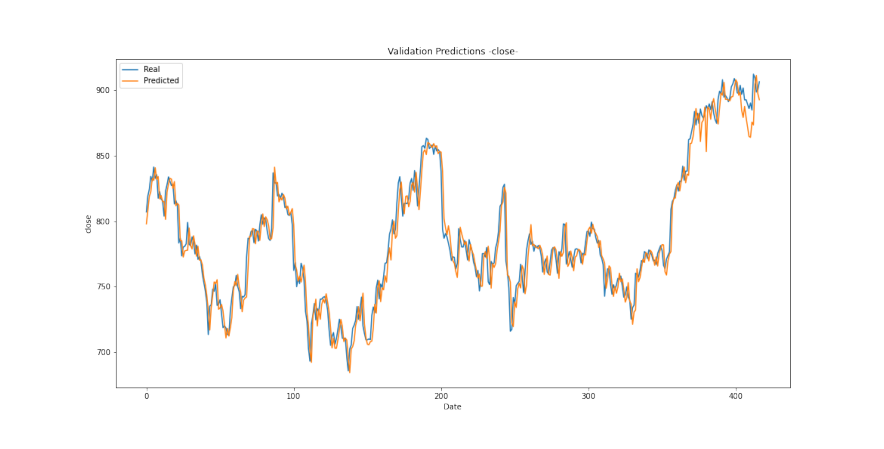

In [9]:
images = []
for epoch in range(num_epochs):
    if (epoch+1)%evaluation_epoch_num == 0 or epoch == 0 or epoch == (num_epochs-1):
        image_path = os.path.join('./plots_lstm_base/', f'validation_predictions_plt_close_e{epoch+1}.png')
        image = plt.imread(image_path)
        images.append(image)
#%%capture
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16,8))
plt.axis("off")

all_images = [[plt.imshow(image, animated=True)] for image in images]
plt.rcParams['animation.embed_limit'] = 2**32
ani = animation.ArtistAnimation(fig, all_images, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

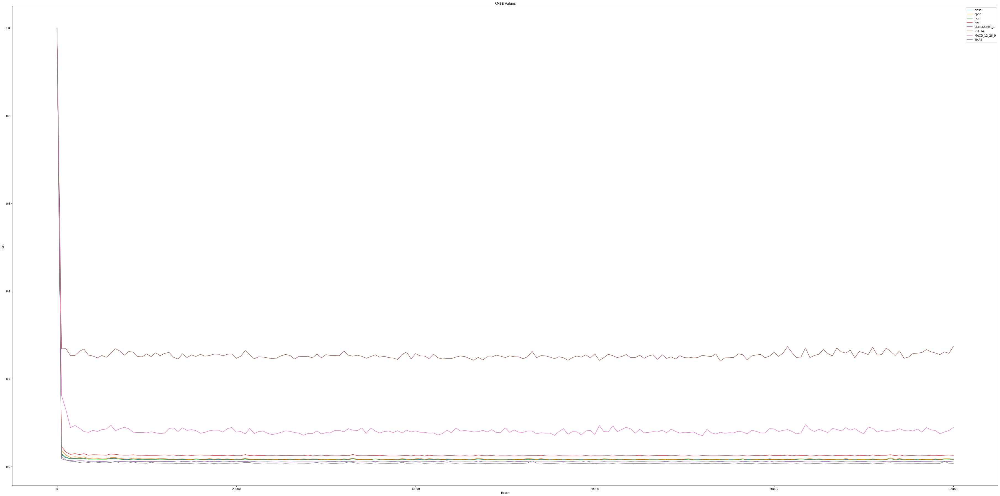

In [24]:
fig = plt.figure(figsize=(64,32))
plt.xlabel("Epoch")
plt.ylabel("RMSE")
plt.title("RMSE Values")
epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
# plt.ylim(0, 5)
for column in columns_used_in_training:
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x, y,label=column)
plt.legend()
fig.savefig(f'./plots_lstm_disc/rmse_all.png')
plt.show()
plt.close(fig)

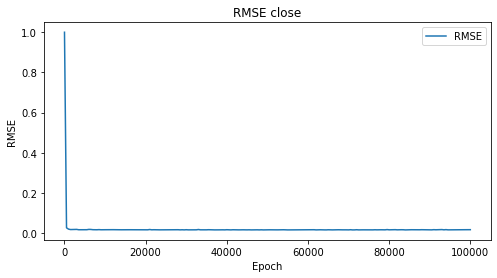

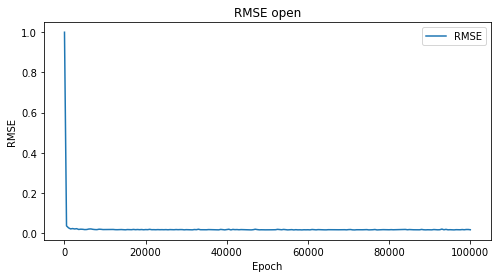

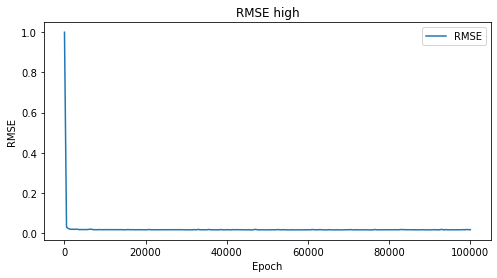

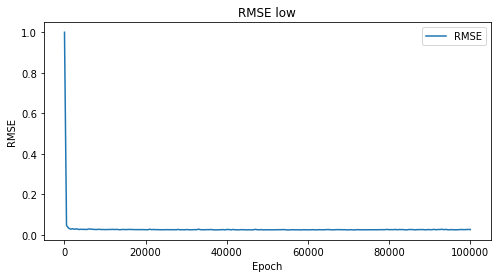

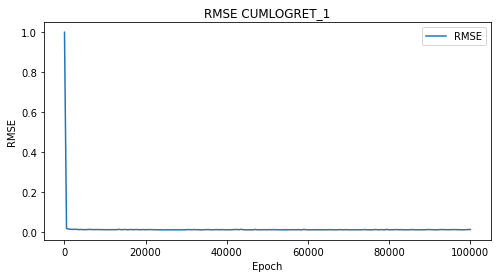

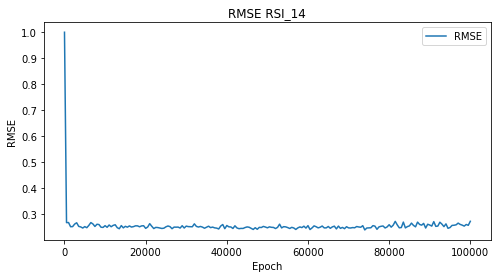

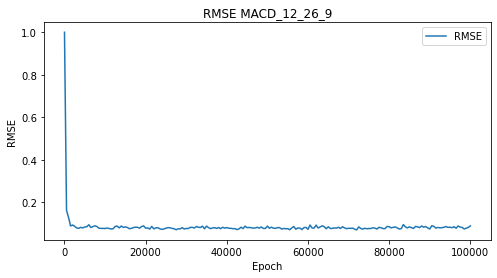

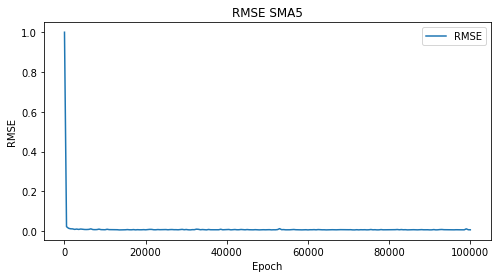

In [25]:
for column in columns_used_in_training:
    fig = plt.figure(figsize=(8,4))
    plt.xlabel("Epoch")
    plt.ylabel("RMSE")
    plt.title(f"RMSE {column}")
    epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
    x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
    # plt.ylim(0, 5)
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x, y,label="RMSE")
    plt.legend()
    fig.savefig(f'./plots_lstm_base/rmse_{column}.png')
    plt.show()
    plt.close(fig)

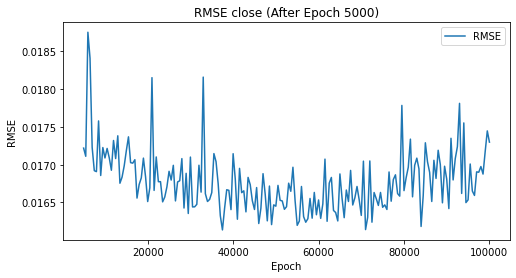

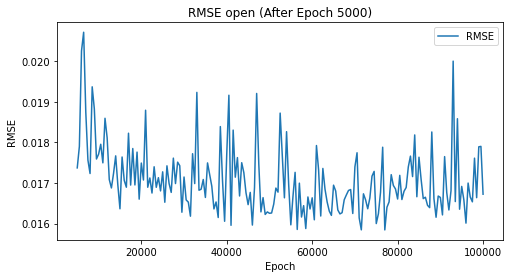

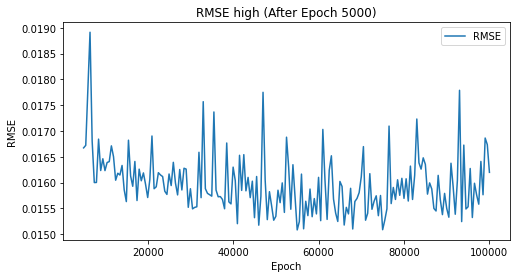

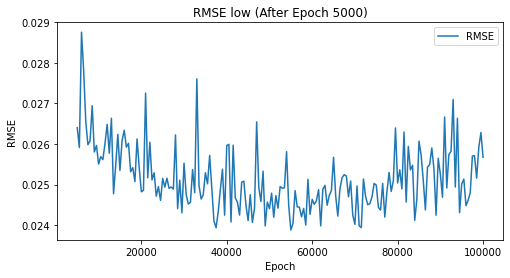

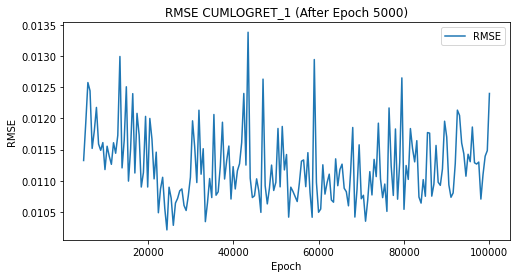

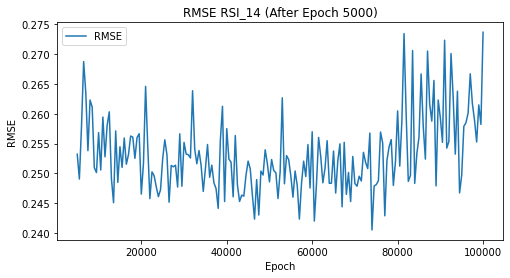

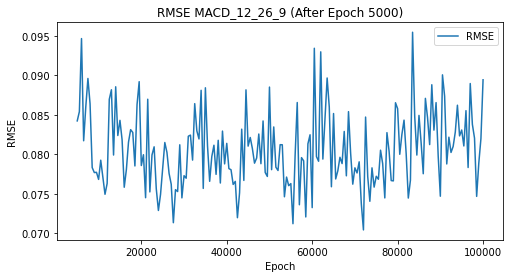

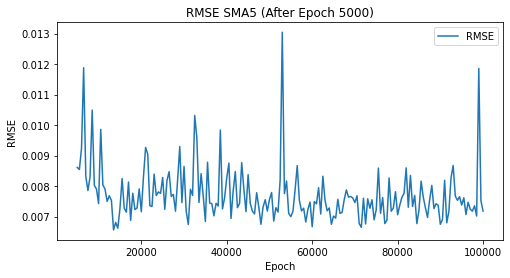

In [26]:
for column in columns_used_in_training:
    fig = plt.figure(figsize=(8,4))
    plt.xlabel("Epoch")
    plt.ylabel("RMSE")
    plt.title(f"RMSE {column} (After Epoch 5000)")
    epoch_len = len(evaluation_metrics["rmse_values"][columns_used_in_training[0]])
    x = [0] + [i for i in range(evaluation_epoch_num, evaluation_epoch_num*epoch_len, evaluation_epoch_num)]
    # plt.ylim(0, 5)
    y = evaluation_metrics["rmse_values"][column]
    y /= max(y)
    plt.plot(x[10:], y[10:],label="RMSE")
    plt.legend()
    fig.savefig(f'./plots_lstm_base/rmse_{column}.png')
    plt.show()
    plt.close(fig)

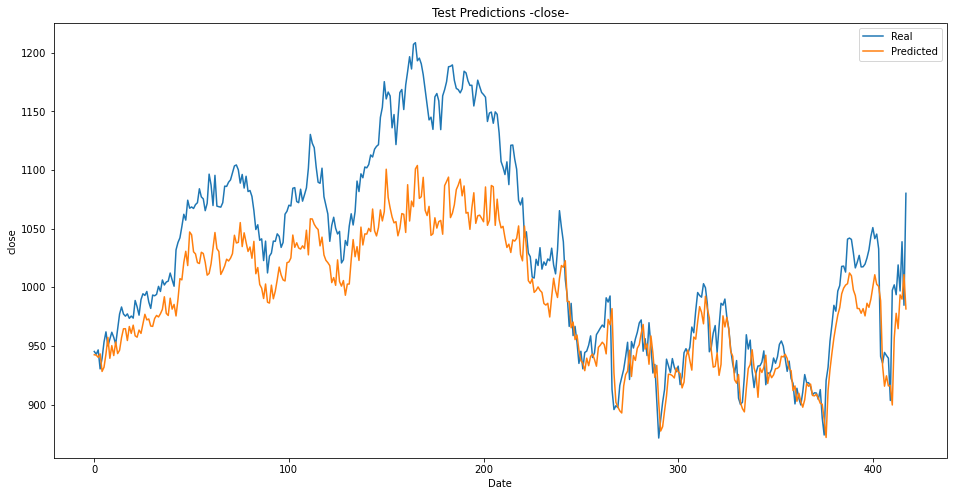

{'close': 50.24911085301811, 'open': 43.82493051317699, 'high': 45.275537680487, 'low': 47.247610625465946, 'CUMLOGRET_1': 0.03885723067270119, 'RSI_14': 10.667718705957292, 'MACD_12_26_9': 2.19552903341355, 'SMA5': 46.37969681410553}


In [27]:
checkpoint = torch.load(os.path.join("./models_lstm_base/","model_epoch_{}.pt".format(best_predictor)))
regressor.load_state_dict(checkpoint['regressor_model_state_dict'])
rmse_values = model_rmse(regressor, test_dataloader, epoch=best_predictor, plot_graph=True, plot_title="Test Predictions", show_preds=True)
print(rmse_values)

In [28]:
best_predictor

37500